## Global Trends in Mental Health Disorder Data Analysis

Name: Manal Afzal

This data science project examines global trends in mental health disorders. It includes information on schizophrenia, bipolar disorder, eating disorders, anxiety disorders, drug use disorders, depression, and alcohol use disorders, organized by year, sex, and country. The aim of this project is to understand the trends and provide a more insightful overview of the patterns with mental health disorders, and to analyze the relationship between the different variables in this dataset. This project focuses on key questions: identifying the top 10 countries with the highest percentage of depressive disorders, exploring correlations or co-occurrence patterns among different mental health disorders, and discerning trends over time (i.e. whether they exhibit an increasing, decreasing, or constant trajectory).

<center><img alt="Insight logo" src="https://buzzrx.s3.amazonaws.com/0b5931ef-9e95-4431-a5e3-d2b59935e687/MentalIllness.png" align="center" hspace="10px" vspace="10px" width="500" height="300" ></center>


## Downloading the Libraries and Dataset

Let's start by importing the libaries and dataset needed.

In [149]:
# Downloading the libraries
import opendatasets as od
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.graph_objs as go 
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True) 


The dataset has been downloaded and extracted.

# Data Preparation and Cleaning

We will now do prepare the data by looking at the columns and rows and handling any missing, incorrect, and invalid data. 
Since we have multiple files in our data source, we must individually read all of the files before we merge them into one file.

In [150]:
schizophrenia_raw_df = pd.read_csv('./prevalence-of-schizophrenia-in-males-vs-females(1).csv')
bipolar_disorder_raw_df = pd.read_csv('./prevalence-of-bipolar-disorder-in-males-vs-females.csv')
eating_disorder_raw_df = pd.read_csv('./prevalence-of-eating-disorders-in-males-vs-females.csv')
anxiety_disorder_raw_df = pd.read_csv('./prevalence-of-anxiety-disorders-males-vs-females.csv')
depression_raw_df = pd.read_csv('./prevalence-of-depression-males-vs-females.csv')

mental_health_raw_df = pd.read_csv('./Mental_health_Depression_disorder_Data.csv')

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\660319130.py:7: DtypeWarning:

Columns (5,6) have mixed types. Specify dtype option on import or set low_memory=False.



Next we must account for missing or incorrect values in each data file, so it makes it easier before we merge all of the files together. To do this, we first check if there are any missing values using the .isnull().values.any() function which returns a boolean (True or False). In our case, it looks like in the schizophrenia data file we have missing values, so now we must delete those values. To better understand where the missing values, we can sum up the null values in each column using the .isnull().sum() function. Now we account for it by utilizing different methods such as .fillna() to fill the columns  based on last valid observation forward, up to a specified limit

In [151]:
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49555, inplace=True)
schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49555, inplace=True)
schizophrenia_raw_df['Population (historical estimates)'].fillna(method='ffill', limit = 739, inplace=True)
schizophrenia_raw_df['Continent'].fillna(method='ffill', limit = 56110, inplace=True)

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\2003946025.py:1: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\2003946025.py:2: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\2003946025.py:3: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\2003946025.py:4: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



Now we can the drop the missing or null values in each column

In [152]:
bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
bipolar_disorder_raw_df['Code'].fillna(method='ffill', limit = 2316, inplace=True)
bipolar_disorder_raw_df['Population (historical estimates)'].fillna(method='ffill', limit = 740, inplace=True)
bipolar_disorder_raw_df['Continent'].fillna(method='ffill', limit = 56110, inplace=True)

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\1261302039.py:1: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\1261302039.py:2: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\1261302039.py:3: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\1261302039.py:4: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\1261302039.py:5: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() inste

In [153]:
eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)'].fillna(method='ffill', limit = 49556, inplace=True)
eating_disorder_raw_df['Code'].fillna(method='ffill', limit = 2316, inplace=True)
eating_disorder_raw_df['Population (historical estimates)'].fillna(method='ffill', limit = 740, inplace=True)
eating_disorder_raw_df['Continent'].fillna(method='ffill', limit = 56110, inplace=True)

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\967380057.py:1: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\967380057.py:2: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\967380057.py:3: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\967380057.py:4: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\967380057.py:5: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.



In [154]:
anxiety_disorder_raw_df = anxiety_disorder_raw_df.copy()

anxiety_disorder_raw_df.copy().dropna(subset=[
                              'Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)',
                              'Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)',
                              'Population (historical estimates)', 'Continent'], inplace=True)


In [155]:
depression_raw_df = depression_raw_df.copy()

depression_raw_df.copy().dropna(subset=[
                              'Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)',
                              'Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)',
                              'Population (historical estimates)', 'Continent'], inplace=True)


Great! Now we have gotten rid of all the missing values. We will now merge all the files into one data source where we can access all of the columns for all mental health disorders. To do this we will now utilize the panda's concact() function

In [156]:
frames = [schizophrenia_raw_df, bipolar_disorder_raw_df, eating_disorder_raw_df, anxiety_disorder_raw_df, depression_raw_df]

In [157]:
result_raw_df = pd.concat(frames)

# Exploratory Analysis and Visualization

The next step involves delving into the data to uncover trends among various mental health conditions and their prevalence across different demographic groups. Specifically, we'll be exploring the relationships between the prevalence of different mental health disorders and their corresponding demographic characteristics.


In [158]:
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (9, 5)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

### Exploring data for mental health disorders in Canada

In [159]:
# prevalence data for depressive disorders by gender
DP_female_prevalance = depression_raw_df['Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)'].sum()
DP_male_prevalance = depression_raw_df['Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)'].sum()

# prevalence data for eating disorders by gender
ED_female_prevalance = eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)'].sum()
ED_male_prevalance = eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)'].sum()

# prevalence data for eating disorders by gender
ed_female_prev = eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)']
ed_male_prev =  eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)']

# Calculate the sum of prevalence for schizophrenia by gender
SC_female_prevalance = schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Female - Age: Age-standardized (Percent)'].sum()
SC_male_prevalance = schizophrenia_raw_df['Prevalence - Schizophrenia - Sex: Male - Age: Age-standardized (Percent)'].sum()

# prevalence data for bipolar disorder by gender
BD_female_prevalance = bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Female - Age: Age-standardized (Percent)'].sum()
BD_male_prevalance = bipolar_disorder_raw_df['Prevalence - Bipolar disorder - Sex: Male - Age: Age-standardized (Percent)'].sum()

# prevalence data for anxiety disorders by gender
AX_female_prevalance = anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)'].sum()
AX_male_prevalance = anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)'].sum()


### Sex Distribution of Mental Health Conditions Percentages 

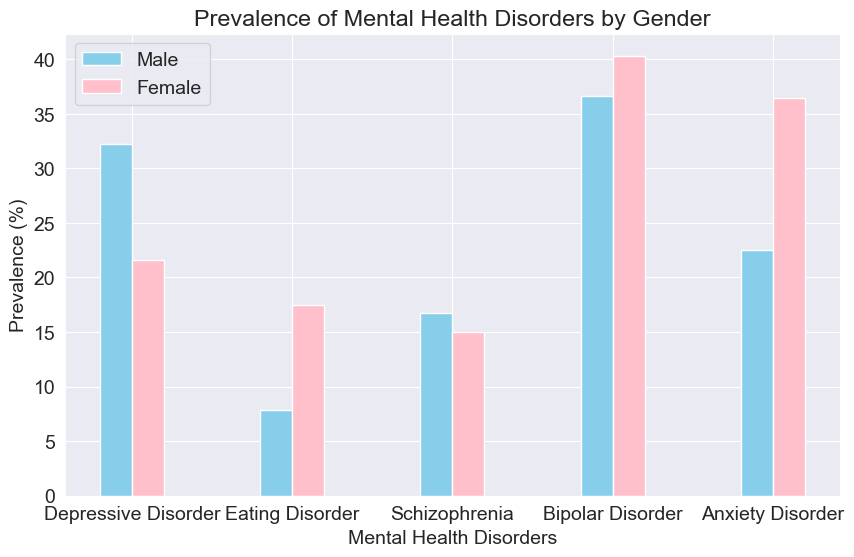

In [160]:
mental_health_disorders = ['Depressive Disorder', 'Eating Disorder', 'Schizophrenia', 'Bipolar Disorder', 'Anxiety Disorder']
male_prevalence = [DP_male_prevalance / 1000, ED_male_prevalance / 1000, SC_male_prevalance / 1000, BD_male_prevalance / 1000, AX_male_prevalance / 1000]
female_prevalence = [DP_female_prevalance / 1000, ED_female_prevalance / 1000, SC_female_prevalance / 1000, BD_female_prevalance / 1000, AX_female_prevalance / 1000]
width = 0.2
index = np.arange(len(mental_health_disorders))

fig, ax = plt.subplots(figsize=(10, 6))
male_bar = ax.bar(index - width/2, male_prevalence, width, label='Male', color='skyblue')
female_bar = ax.bar(index + width/2, female_prevalence, width, label='Female', color='pink')

ax.set_xlabel('Mental Health Disorders')
ax.set_ylabel('Prevalence (%)')
ax.set_title('Prevalence of Mental Health Disorders by Gender')
ax.set_xticks(index)
ax.set_xticklabels(mental_health_disorders)
ax.legend()


## Geographical Distribution of Mental Health Conditions 

Now let's look at the depression percentages in North America. To begin this exploration, the choice of graph will be to use a polygraph map to understand which country has more depression prevelance. Let us first add all the countries in North America in a string so we can see add them to the data frame.

In [161]:
# Make a list of North American countries
country_north_america = [
                            'Canada', 'United States', 
                            'Mexico', 'Costa Rica', 
                            'Jamaica', 'Honduras', 
                            'Panama', 'Cuba', 
                            'Dominican Republic', 
                            'Haiti', 'Guatemala', 
                            'Nicaragua', 'El Salvador', 
                            'Belize', 'Bahamas', 
                            'Barbados', 'Trinidad and Tobago', 
                            'Dominica', 'Saint Lucia', 
                            'Saint Vincent and the Grenadines', 
                            'Grenada', 'Antigua and Barbuda'
                         ]

Let us now define a new variable called north that filters only the North American country in the depression dataframe column Enitity. This is done to ensure that the new dataframe North only stores the rows where Entity column matches the North American country names.

In [162]:
north = depression_raw_df[depression_raw_df['Entity'].isin(country_north_america)]


We now create two dictionaries data and layout that is used for plotting a map using the Geopandas library. The data's parameters are related to each country on the map, including the color scale, location data, prevalence values, and text labels. The layout parameters focuses on the layout aspects of the graph, such as the title, geographic scope (North America), projection type (natural earth), and the display of the map frame.

### Depression Percentages In North America

In [163]:
female_prev = depression_raw_df['Prevalence - Depressive disorders - Sex: Female - Age: Age-standardized (Percent)']
male_prev =  depression_raw_df['Prevalence - Depressive disorders - Sex: Male - Age: Age-standardized (Percent)']

In [164]:
# Plotting depression for females 
north_dep_data = dict(type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Depression %'}
                )

north_dep_layout = dict(title = 'Depression in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True)
            )

In [165]:
go.Figure(data = [north_dep_data],layout = north_dep_layout) 
choromap = go.Figure(data = [north_dep_data], layout = north_dep_layout) 
iplot(choromap)

We then use the Geopandas's function go.Figure to display the map for Depression in Females by initializing the dep_data and dep_layout parameters.  We use the iPlot to display the Go Functions which is primarily used in Jupyter notebooks to display the interactive graphs. 

Now we will plot a map using the Geopandas library for depression for Males in North American countries

In [166]:
north_dep_data  = dict(
                type= 'choropleth',
                colorscale = 'Viridis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Depression %'}
                )

north_dep_layout  = dict(title = 'Depression in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True)
            )

In [167]:
go.Figure(data = [north_dep_data],layout = north_dep_layout) 
choromap = go.Figure(data = [north_dep_data], layout = north_dep_layout) 
iplot(choromap)

### Eating Disorder Percentages In North America

In [168]:
ed_female_prev = eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Female - Age: Age-standardized (Percent)']
ed_male_prev =  eating_disorder_raw_df['Prevalence - Eating disorders - Sex: Male - Age: Age-standardized (Percent)']

In [169]:
north_eating_disorders_data = dict(type= 'choropleth',
                colorscale = 'Cividis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = ed_female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

north_eating_disorders_layout = dict(title = 'Eating Disorders in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [170]:
go.Figure(data = [north_eating_disorders_data],layout = north_eating_disorders_layout) 
choromap = go.Figure(data = [north_eating_disorders_data], layout = north_eating_disorders_layout) 
iplot(choromap)

In [171]:
north_eating_disorders_data = dict(type= 'choropleth',
                colorscale = 'Cividis',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

north_eating_disorders_layout = dict(title = 'Eating Disorders in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True)
            )

In [172]:
go.Figure(data = [north_eating_disorders_data],layout = north_eating_disorders_layout) 
choromap = go.Figure(data = [north_eating_disorders_data], layout = north_eating_disorders_layout) 
iplot(choromap)

### Schizophrenia Percentages In North America

In [173]:
north_schizophrenia_data = dict(type= 'choropleth',
                colorscale = 'Inferno',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

north_schizophrenia_layout = dict(title = 'Schizophrenia in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [174]:
go.Figure(data = [north_schizophrenia_data],layout = north_schizophrenia_layout) 
choromap = go.Figure(data = [north_schizophrenia_data], layout = north_schizophrenia_layout) 
iplot(choromap)

In [175]:
north_schizophrenia_data = dict(type= 'choropleth',
                colorscale = 'Inferno',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Eating Disorders %'}
                )

north_schizophrenia_layout = dict(title = 'Schizophrenia in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [176]:
go.Figure(data = [north_schizophrenia_data],layout = north_schizophrenia_layout) 
choromap = go.Figure(data = [north_schizophrenia_data], layout = north_schizophrenia_layout) 
iplot(choromap)

### Bipolar Use Percentages In North America

In [177]:
# bipolar percentage for females 
north_bipolar_data = dict(type= 'choropleth',
                colorscale = 'Plasma',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Bipolar Use Disorder %'}
                )

north_bipolar_layout = dict(title = 'Bipolar Use Disorder in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [178]:
go.Figure(data = [north_bipolar_data],layout = north_bipolar_layout) 
choromap = go.Figure(data = [north_bipolar_data], layout = north_bipolar_layout) 
iplot(choromap)

In [179]:
north_bipolar_data = dict(type= 'choropleth',
                colorscale = 'Plasma',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Bipolar Use Disorder %'}
                )

north_bipolar_layout = dict(title = 'Bipolar Use Disorder in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [180]:
go.Figure(data = [north_bipolar_data],layout = north_bipolar_layout) 
choromap = go.Figure(data = [north_bipolar_data], layout = north_bipolar_layout) 
iplot(choromap)

### Anxiety Use Disorder in North America 

In [181]:
# Adding labels for male and female prevelances of anxiety use disorder in North America
female_prev = anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Female - Age: Age-standardized (Percent)']
male_prev =  anxiety_disorder_raw_df['Prevalence - Anxiety disorders - Sex: Male - Age: Age-standardized (Percent)']

In [182]:
# Adding a data dictionary and layout dictionary to graph a map for anxiety in North America
north_anxiety_use_data = dict(type= 'choropleth',
                colorscale = 'Portland',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = female_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Anxiety Disorder %'}
                )

north_anxiety_use_layout = dict(title = 'Anxiety Disorder in North America for Females', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}, showframe = True))

In [183]:
go.Figure(data = [north_anxiety_use_data],layout = north_anxiety_use_layout) 
choromap = go.Figure(data = [north_anxiety_use_data], layout = north_anxiety_use_layout) 
iplot(choromap)

In [184]:
north_anxiety_use_data = dict(
                type= 'choropleth',
                colorscale = 'Portland',
                reversescale = True,
                locations = north['Entity'],
                locationmode = 'country names',
                z = male_prev,
                text = north['Entity'],
                colorbar = {'title' : 'Anxiety Disorder %'}
                )

north_anxiety_use_layout = dict(title = 'Anxiety in North America for Males', 
                  geo = dict({'scope': 'north america'}, projection = {'type': 'natural earth'}))

In [185]:
go.Figure(data = [north_anxiety_use_data],layout = north_anxiety_use_layout) 
choromap = go.Figure(data = [north_anxiety_use_data], layout = north_anxiety_use_layout) 
iplot(choromap)

## Discussion

### Gender Trends Of Different Mental Health Conditions

<center><img alt="Insight logo" src="https://www.solhapp.com/blog/storage/untitled-design-48.jpg" align="center" hspace="10px" vspace="10px" width="300" height="300" ></center>


This analysis of mental health disorders data reveals compelling sex-specific trends. 

Depression:

- Females exhibited a 19.2% higher likelihood of depression in comparison to men.

Anxiety Disorders:

- Females have a twofold higher prevalence of anxiety disorders.

Eating Disorders:

- There's a significant gender gap in eating disorders, with females experiencing double the prevalence.

Schizophrenia:

- Males have a 5.6% higher chance of schizophrenia.

Bipolar Use Disorder:

- Females are 4.8% more likely to have bipolar use disorder.

Understanding these sex disparities is crucial for tailoring effective mental health interventions and support systems to help those that suffer from these mental health conditions.

### Dempographic Trends Of Different Mental Health Conditions

<center><img alt="Insight logo" src="https://assets-global.website-files.com/64205e229a708b6b93a532a3/64289986f47c95daa6474074_2.png" align="center" hspace="10px" vspace="10px" width="400" height="300" ></center>

This North American mental health disorders analysis reveals these notable patterns:

Depression:

- Similar percentages for females in Canada and the United States.

- Highest rates for males in Honduras, El Salvador, and the United States.

Eating Disorders:

- Females percentages show double the prevalence of males.

- El Salvador leads in female eating disorders, while Costa Rica tops for males.

Schizophrenia:

- El Salvador tops for females, while Honduras for males.

Anxiety Disorders:

- Canada and El Salvador lead for females.
Canada, El Salvador, Panama, and Honduras lead for males.

# Asking and Answering Questions

We have now analyzed and visualized key aspects of our data such as gender and region explorations for each mental health disorder in our data frame such as anxiety, depression, bipolar disorder, anxiety disorder, and schizophrenia. All of these questions will be related specifically to Canada. 

### Questions I am to answer:

1. What are the top 10 countries with the highest percentage of Depressive Disorder?

2. Which mental health disorders exhibit a higher prevalence rate among males compared to females? Among females, which mental health disorders have a higher prevalence rate compared to males?

4. Which mental health disorders have shown an increase, decrease, or remained stable in prevalence over time?


### Exploring data for mental health disorders in Canada

#### 1. What are the top 10 countries with the highest percentage of Depressive Disorder?

In [186]:
converting_columns = ['Schizophrenia (%)', 'Bipolar disorder (%)', 'Eating disorders (%)', 
                      'Anxiety disorders (%)', 'Drug use disorders (%)', 'Depression (%)',
                      'Alcohol use disorders (%)']

# Convert specified columns to numeric, coerce non-numeric values to NaN
mental_health_raw_df[converting_columns] = mental_health_raw_df[converting_columns].apply(pd.to_numeric, errors='coerce')

In [187]:
mean = mental_health_raw_df.groupby('Entity')[['Schizophrenia (%)', 'Bipolar disorder (%)','Eating disorders (%)', 
                                          'Anxiety disorders (%)', 'Drug use disorders (%)', 'Depression (%)',
                                          'Alcohol use disorders (%)']].mean().reset_index()

C:\Users\manal\AppData\Local\Temp\ipykernel_6484\4241942718.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




Text(0, 0.5, 'Average Percentage %')

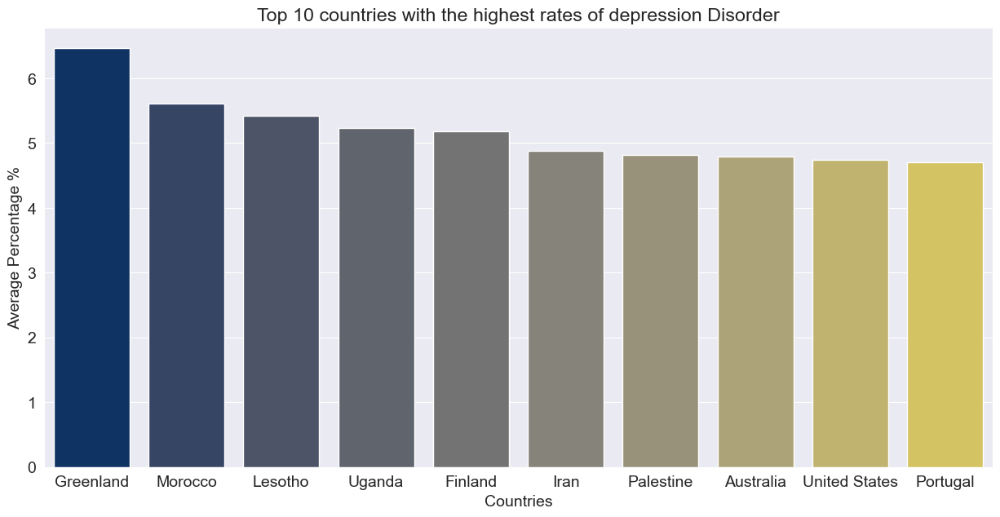

In [188]:
plt.figure(figsize = (15,7))
sns.barplot(data = mean, 
            x = 'Entity', 
            y = 'Depression (%)', 
            order = mean.sort_values('Depression (%)', ascending = False).Entity.head(10),
            palette = 'cividis')

#Set title, legend and x y axis
plt.title('Top 10 countries with the highest rates of depression Disorder',
          fontweight='light')

plt.xlabel('Countries')
plt.ylabel('Average Percentage %')


### Analysis

The top ten countries with the highest depression percentage is Greenland, Morocco, Lesotho, Uganda, Finland, Iran, Palestine, Australia, United States, and Portugal. The country with the highest depression percentage is Greenland.

### 2. Are there any correlations or co-occurrence patterns between the mentioned mental health conditions based on the available data?


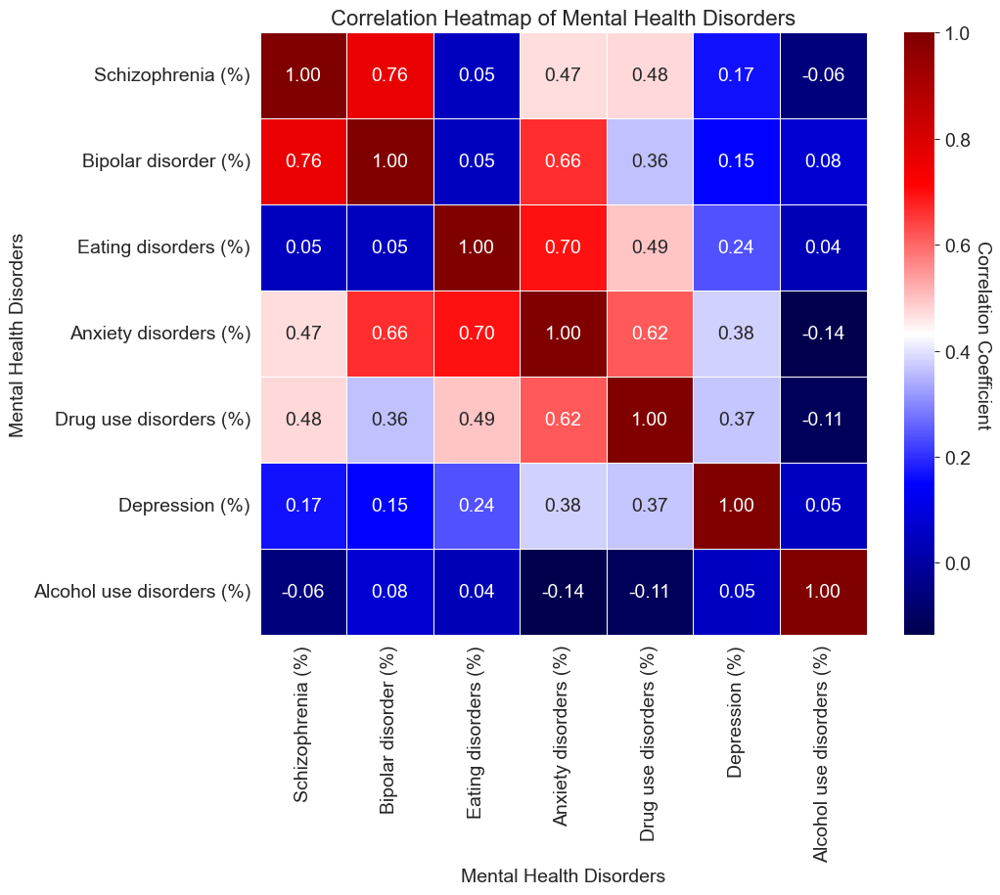

In [189]:
# selecting numeric columns
num_column = mental_health_raw_df[mental_health_raw_df.columns[2:11]].select_dtypes(include='number')

# calculating correlation matrix
corr = num_column.corr()

# plotting heatmap
plt.figure(figsize=(10, 8))
heatmap = sns.heatmap(corr, cmap="seismic", annot=True, fmt=".2f", linewidths=.5)

# title and labels
plt.title('Correlation Heatmap of Mental Health Disorders', fontsize=16)
plt.xlabel('Mental Health Disorders', fontsize=14)
plt.ylabel('Mental Health Disorders', fontsize=14)

# colorbar
cbar = heatmap.collections[0].colorbar

# rotating the x labels 
cbar.set_label('Correlation Coefficient', rotation=270, labelpad=15)

plt.show()

### Analysis

As we can see from this graph, the strongest correlation between these mental health disorder is Schizophrenia and Bipolar Disorder. There is also a connection between anxiety disorder and eating disorders. 

### 3. Are there any trends of the mental health disorders over a period of time. i.e increasing, decreasing, or remained constant over time?


The choice of graph I have used is a line graph, I wanted to display all the mental health disorders seperately, so I have utilized the subplots() matplotlib function to display all the percentages of mental health disorders over a period of time.

In [190]:
canada_df_2 = mental_health_raw_df[mental_health_raw_df['Entity'] == 'Canada']

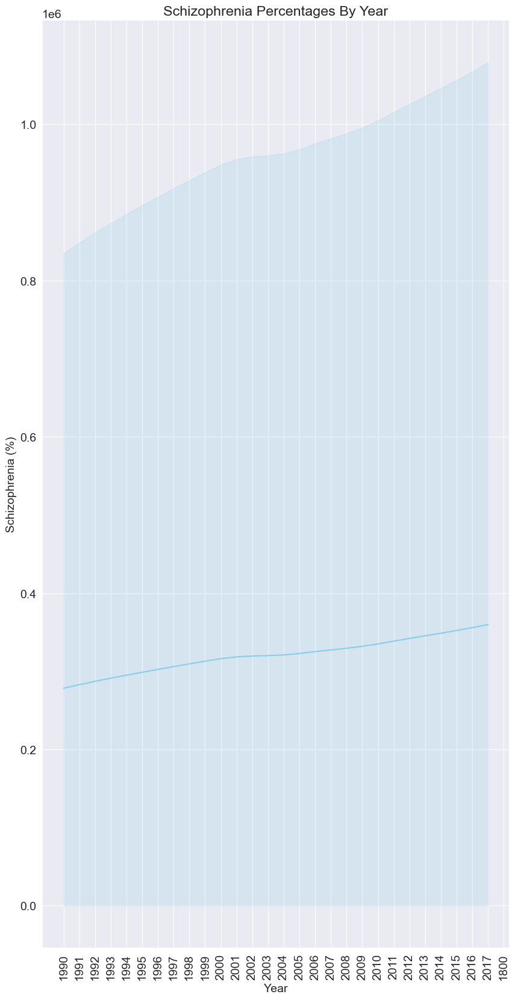

In [191]:
plt.figure(figsize=(10, 20))

# Smooth the line using the 'lowess' estimator
sns.lineplot(data=canada_df_2, x="Year", y="Schizophrenia (%)", color='skyblue')

plt.title('Schizophrenia Percentages By Year')
plt.xticks(rotation=90)

plt.show()


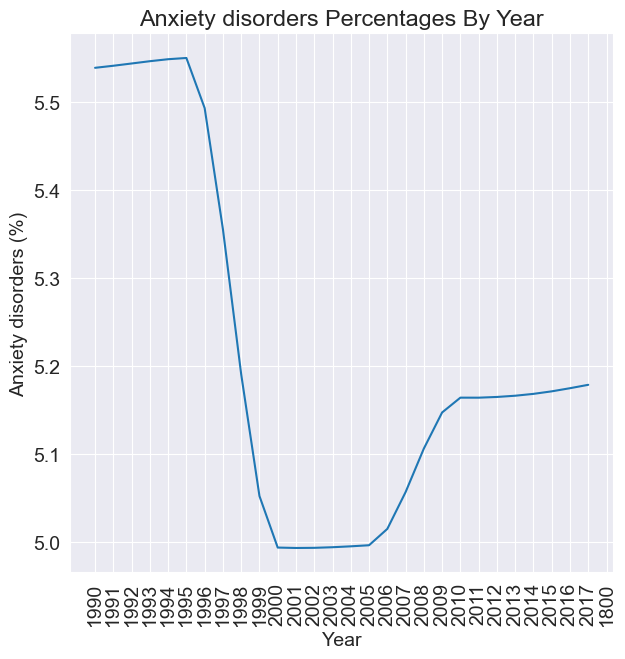

In [192]:
plt.figure(figsize=(7, 7))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Anxiety disorders (%)")
plt.title('Anxiety disorders Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

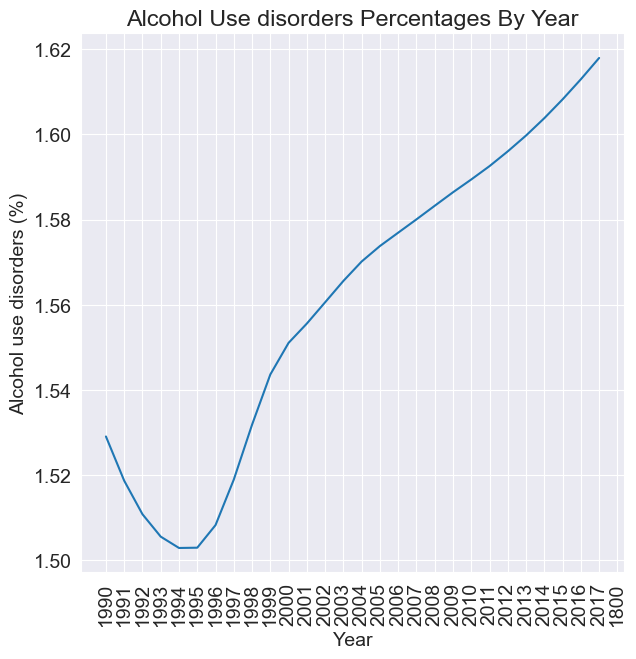

In [193]:
plt.figure(figsize=(7, 7))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Alcohol use disorders (%)")
plt.title('Alcohol Use disorders Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

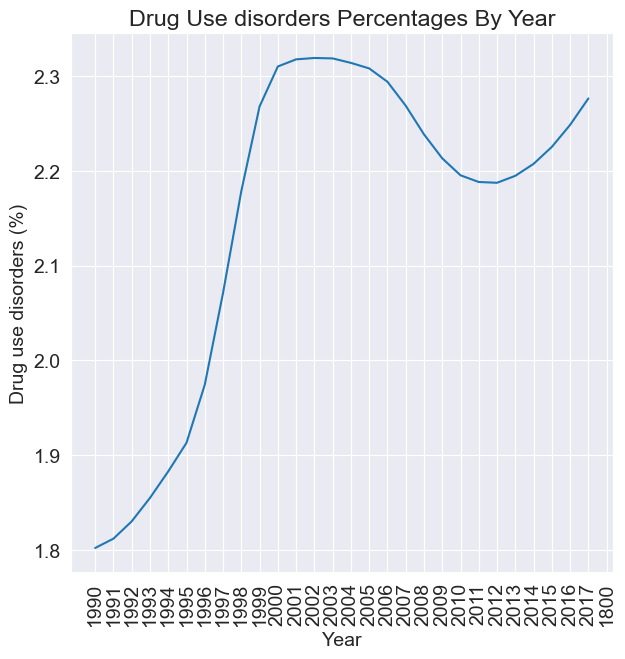

In [194]:
plt.figure(figsize=(7, 7))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Drug use disorders (%)")
plt.title('Drug Use disorders Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees

plt.show()

In [195]:
canada_df_2['Bipolar disorder (%)'].dropna()

952         0.716075
953         0.716383
954         0.716693
955         0.716988
956         0.717223
            ...     
61810    3577.865017
61811    3584.608405
61812    3594.238040
61813    3607.397383
61814    3623.459725
Name: Bipolar disorder (%), Length: 84, dtype: float64

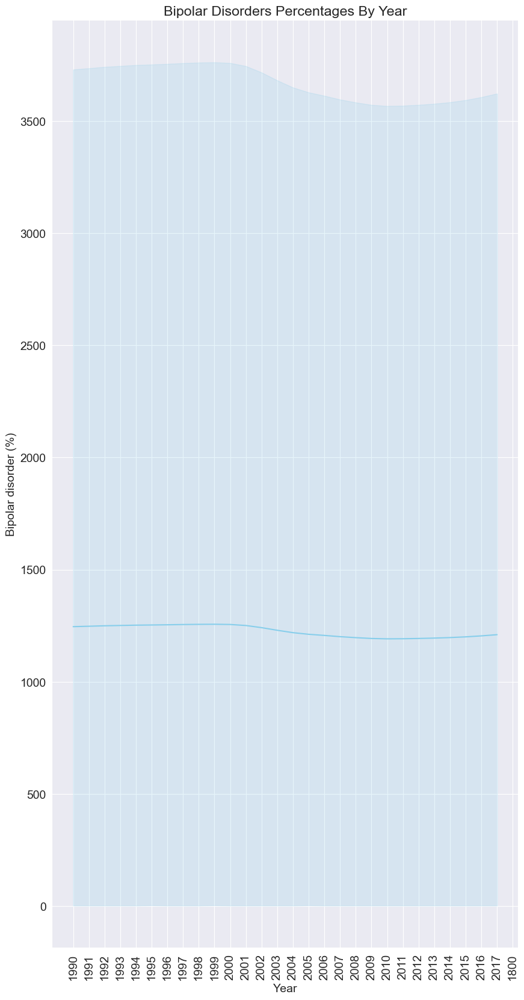

In [196]:
plt.figure(figsize=(10, 20))

sns.lineplot(data=canada_df_2, x="Year", y="Bipolar disorder (%)", color='skyblue')

plt.title('Bipolar Disorders Percentages By Year')

plt.xticks(rotation=90)
plt.show()


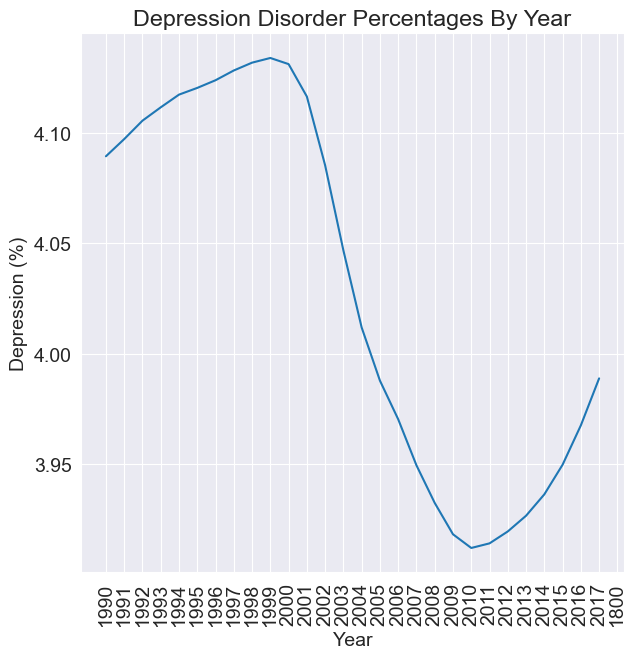

In [197]:
plt.figure(figsize=(7, 7))  # Set the figure size

sns.lineplot(data=canada_df_2, x="Year", y="Depression (%)")

plt.title('Depression Disorder Percentages By Year')
plt.xticks(rotation=90)  # Rotate the x-axis labels by 90 degrees
plt.show()

### Analysis

From the depicted trends in the graphs, it's apparent that the prevalence of bipolar disorder and schizophrenia has exhibited relative stability over the years. On the contrary, both depression and anxiety disorders have shown a general decline, although recent years indicate a subtle upward curve, suggesting a potential resurgence.

In contrast, the graphs for drug use disorder and alcohol use disorder reveal an alarming increase in prevalence over the observed time span. This observed rise prompts further exploration into the factors contributing to the escalating rates of substance-related disorders. 

# Conclusion

#### Here are the questions I aim to answer in this dataset:

1. What are the top 10 countries with the highest percentage of Depressive Disorder?

2. Are there any correlations or co-occurrence patterns between different mental health disorders based on the available data?

3. Are there any trends of the mental health disorders over a period of time. i.e increasing, decreasing, or remained constant over time?


#### Here are the results to these questions:

1. The top ten countries with the highest depression percentage is Greenland, Morocco, Lesotho, Uganda, Finland, Iran, Palestine, Australia, United States, and Portugal, indicating significant global disparities in mental health.

2. The strongest correlation between the mentioned mental health conditions is Schizophrenia and Bipolar Disorder. There is also a connection between anxiety disorder and eating disorders. The correlation between Schizophrenia and Bipolar Disorder suggests that are shared factors. And vice versa, where the association between anxiety disorder and eating disorders implies potential co-occurences or shared risk factors. 

3. Yes there is! Bipolar disorder and schizophrenia has remained constant over the years. Depression and anxiety disorders have decreased over the years but it the graph is curving upwards. Drug use disorder and alcohol use disorder have increased over the years. The increase in drug use disorder and alcohol use disorder raises concerns about the substance-related policies over time, and raises concerns about societal impacts.


# References 

Here are all the documentation that has helped me complete this datascience project. Feel free to check it out. There are links to the libraries that I used, and the graphing documentation such as seaborn, matplotlib and plotly. Also I researched some more graphs such as heatmaps and chloroleth maps.

Dataset Link: 

- https://www.kaggle.com/datasets/thedevastator/gender-mental-disorder-prevalence-2019

Libraries Used for Dataframe: 

- https://pandas.pydata.org/

Graphing Libraries:

- https://matplotlib.org/

- https://seaborn.pydata.org/

In order to make the chloroleth maps, I used this documentation:

- https://plotly.com/python/choropleth-maps/

- https://www.kaggle.com/code/leonardofida/choropleth-maps

In order to make the heat maps, I used this documentation: 

- https://python-charts.com/correlation/heatmap-matplotlib/


Images Used:

- https://buzzrx.s3.amazonaws.com/0b5931ef-9e95-4431-a5e3-d2b59935e687/MentalIllness.png

- https://assets-global.website-files.com/64205e229a708b6b93a532a3/64289986f47c95daa6474074_2.png

- https://www.solhapp.com/blog/storage/untitled-design-48.jpg